# This is the code for the 'Task 1: Dataset Distillation with Attention Matching' Question 2. Dataset Distillation Learning - MHIST Dataset

    ########################################### Code start here for MHIST Dataset ############################################

# Import Required Libraries

In [ ]:
!pip install nbimporter
!pip install torch torchvision
!pip install fvcore
!pip install thop
!pip install matplotlib

# Import Required Functions

In [11]:
import sys
sys.path.append('C:\\Users\\manis\\Documents\\ECE digital image processing_Class\\Project A')

import nbimporter
from networks import ConvNet 
from utils import get_dataset, get_loops, get_eval_pool, evaluate_synset, get_default_convnet_setting, get_network

import os
import time
import zipfile
import random
import thop
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, TensorDataset
from torch.optim.lr_scheduler import CosineAnnealingLR
import matplotlib.pyplot as plt
from collections import Counter

from torchvision.utils import save_image
from torchvision import datasets, transforms
import pandas as pd
from PIL import Image

device = torch.device('cpu')

# Load datasets

In [12]:
data_path = 'C:/Users/mahagam3/Documents/ECE course/Project A'
zip_file_path = os.path.join(data_path, 'images.zip')  
extract_folder = os.path.join(data_path, 'images')  
os.makedirs(extract_folder, exist_ok=True)

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

print(f'Images extracted to {extract_folder}')

Images extracted to C:/Users/mahagam3/Documents/ECE course/Project A\images


In [13]:
data_path = 'C:/Users/mahagam3/Documents/ECE course/Project A/images/images'
annotations_path = os.path.join(data_path, 'annotations.csv') 
annotations = pd.read_csv(annotations_path)

# Resize transformation for images
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 32x32
    transforms.ToTensor()  # Convert to tensor
])

class MHISTDataset(Dataset):
    def __init__(self, annotations, data_path, partition, transform=None):
        self.annotations = annotations[annotations['Partition'] == partition]  # Filter based on partition
        self.data_path = data_path
        self.transform = transform  # Use the transform passed in

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        img_name = self.annotations.iloc[idx]['Image Name']  # Get image name
        label = self.annotations.iloc[idx]['Majority Vote Label']  # Get label from the updated column
        label = 0 if label == 'HP' else 1 
        
        # Load image
        image = Image.open(os.path.join(self.data_path, img_name)).convert("RGB")
        
        # Apply transformation if provided
        if self.transform:
            image = self.transform(image)
        
        return image, label

# Create datasets for training and testing
mhist_train = MHISTDataset(annotations, data_path, partition='train', transform=transform)
mhist_test = MHISTDataset(annotations, data_path, partition='test', transform=transform)

# Create DataLoaders
mhist_loader = DataLoader(mhist_train, batch_size=64, shuffle=True)
mhist_test_loader = DataLoader(mhist_test, batch_size=64, shuffle=False)

In [14]:
class_counts = annotations['Majority Vote Label'].value_counts()
print("Number of images per class:")
print(class_counts)

Number of images per class:
Majority Vote Label
HP     2162
SSA     990
Name: count, dtype: int64


In [15]:
#################### Edit to MHIST ###################
 ###### MHIST Dataset ######
from collections import Counter

# Initialize a counter for the classes
class_counts = Counter()

# Iterate through the training dataset
for _, label in mhist_train:
    class_counts[label] += 1  # Increment the count for the corresponding class

# Print the number of images per class
for class_label, count in class_counts.items():
    print(f"Class {class_label}: {count} images")

Class 1: 630 images
Class 0: 1545 images


In [16]:
# Define parameters for MHIST ConvNet7
channel_mhist = 3  
num_classes_mhist = 2 
im_size_mhist = (224, 224)

# Resize MHIST images
transform_resize = transforms.Compose([
    transforms.Resize(im_size_mhist),  
    transforms.ToTensor() 
])

# # Instantiate ConvNetD3
convnet7 = get_network('ConvNetD7', channel_mhist, num_classes_mhist, im_size_mhist).to('cpu')

optimizer7 = optim.SGD(convnet7.parameters(), lr=0.01) # Define optimizer
criterion = nn.CrossEntropyLoss() # Define loss function
scheduler7 = CosineAnnealingLR(optimizer7, T_max=20) # Cosine Annealing Scheduler

# Create datasets for training and testing
mhist_train = MHISTDataset(annotations, data_path, partition='train', transform=transform)
mhist_test = MHISTDataset(annotations, data_path, partition='test', transform=transform)

# Create DataLoaders
mhist_loader = DataLoader(mhist_train, batch_size=64, shuffle=True)
mhist_test_loader = DataLoader(mhist_test, batch_size=64, shuffle=False)

# Part 1 Question 2(a):
Train the selected model with the original dataset and report the classification accuracy along  with floating-point operations per second (FLOPs) for the test set. Use SGD as an optimizer
with a cosine annealing scheduler with an initial learning rate of 0.01 for 20 epochs. (For more information on experimental setting, look at the implementation details of [51]) These scores give you the upper bound benchmark evaluation.

In [17]:
# Training Function
def train_model(model, dataloader, optimizer, criterion, scheduler, num_epochs=20):
    model.train()  # Set the model to training mode
    start_time = time.time()  # Start timing
    for epoch in range(num_epochs):
        running_loss = 0.0
        for images, labels in dataloader:
            optimizer.zero_grad()  # Zero the parameter gradients
            images, labels = images.to(device), labels.to(device)  # Move to device
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss
            loss.backward()  # Backward pass
            optimizer.step()  # Optimize the model
            running_loss += loss.item()
        
        scheduler.step()  # Step the learning rate scheduler
        
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(dataloader):.4f}')

    total_training_time = time.time() - start_time  # Calculate total time
    print(f"Training Time on Real MHIST Dataset: {total_training_time:.2f} seconds")
    return total_training_time

def evaluate_model(model, dataloader):
    model.eval()  # Set the model to evaluation mode
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in dataloader:
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    
    accuracy = 100 * correct / total
    
    return accuracy

In [9]:
# Training ConvNet7 on MHIST
print("Training ConvNet7 on MHIST...")
train_model(convnet7, mhist_loader, optimizer7, criterion, scheduler7)

# Evaluate ConvNet7 on test set
accuracy_mhist = evaluate_model(convnet7, mhist_test_loader)
print(f'ConvNet7 Test Accuracy on MHIST: {accuracy_mhist:.2f}%')

Training ConvNet7 on MHIST...
Epoch [1/20], Loss: 0.6157
Epoch [2/20], Loss: 0.5721
Epoch [3/20], Loss: 0.5517
Epoch [4/20], Loss: 0.5324
Epoch [5/20], Loss: 0.5165
Epoch [6/20], Loss: 0.5010
Epoch [7/20], Loss: 0.4808
Epoch [8/20], Loss: 0.4656
Epoch [9/20], Loss: 0.4512
Epoch [10/20], Loss: 0.4384
Epoch [11/20], Loss: 0.4254
Epoch [12/20], Loss: 0.4087
Epoch [13/20], Loss: 0.3959
Epoch [14/20], Loss: 0.3883
Epoch [15/20], Loss: 0.3780
Epoch [16/20], Loss: 0.3713
Epoch [17/20], Loss: 0.3669
Epoch [18/20], Loss: 0.3633
Epoch [19/20], Loss: 0.3606
Epoch [20/20], Loss: 0.3598
Training Time on Real MHIST Dataset: 6050.22 seconds
ConvNet7 Test Accuracy on MHIST: 76.97%


In [10]:
# Flop is used to measure the coputational cost of running the model and to evaluate the efficiency of the learning model.
# Calculate FLOPs (Floating Point Operations per Second)
def calculate_flops(model, input_tensor):
    from thop import profile
    
    # Clear any existing 'total_ops' and 'total_params' attributes
    for layer in model.modules():
        if hasattr(layer, 'total_ops'):
            del layer.total_ops  # Remove existing 'total_ops'
        if hasattr(layer, 'total_params'):
            del layer.total_params  # Remove existing 'total_params'

    # Now calculate FLOPs
    flops, params = profile(model, inputs=(input_tensor,))
    return flops

# Input tensor for calculating FLOPs
input_tensor_mhist = torch.randn(len(mhist_train), channel_mhist, 224, 224)
flops_mhist = calculate_flops(convnet7, input_tensor_mhist)
print(f'FLOPs for ConvNet7: {flops_mhist:.2f} FLOPs')

# # This part gives the FLOPS: but there is an "Unsupported operator aten::avg_pool2d encountered 3 time(s)" error, meaning there can be 
# # This error comes because the FLOPS is not supported by the library "from fvcore.nn import FlopCountAnalysis"
# from fvcore.nn import FlopCountAnalysis
# flops_mhist = FlopCountAnalysis(convnet7, torch.randn(len(mhist_train), channel_mhist, 32, 32).to(device))
# print(f'FLOPs for ConvNet7: {flops_mhist:.2f} FLOPs')

[INFO] Register count_convNd() for <class 'torch.nn.modules.conv.Conv2d'>.
[INFO] Register zero_ops() for <class 'torch.nn.modules.activation.ReLU'>.
[INFO] Register count_avgpool() for <class 'torch.nn.modules.pooling.AvgPool2d'>.
[INFO] Register zero_ops() for <class 'torch.nn.modules.container.Sequential'>.
[INFO] Register count_linear() for <class 'torch.nn.modules.linear.Linear'>.
FLOPs for ConvNet7: 5743561545600.00 FLOPs


# Part 1: Question 2(b): 
Learn the synthetic dataset S using the selected model and Attention Matching algorithm. For initialization of condensed images, randomly select from real training images. The experimental setup can be found in Table 1.

In [18]:
# Set hyperparameters for MHIST
K_mhist = 200
T_mhist = 10
eta_S_mhist = 0.1
zeta_S_mhist = 1
eta_theta_mhist = 0.01
zeta_theta_mhist = 50
lambda_mhist = 0.01
num_classes_mhist = 2
images_per_class_mhist = 50
batch_size_mhist = 128

In [19]:
# Function to generate a synthetic dataset S by randomly sampling from a real dataset
def generate_synthetic_dataset(real_dataset, num_classes, images_per_class):
    synthetic_images = []
    synthetic_labels = []
    
    for class_id in range(num_classes):
        indices = random.sample(
            [i for i, (_, label) in enumerate(real_dataset) if label == class_id],
            images_per_class
        )
        synthetic_images.extend([real_dataset[i][0] for i in indices])
        synthetic_labels.extend([real_dataset[i][1] for i in indices])
    
    return synthetic_images, synthetic_labels

In [20]:
# Generate synthetic samples for MHIST
synthetic_images_mhist, synthetic_labels_mhist = generate_synthetic_dataset(
    mhist_train, num_classes_mhist, images_per_class_mhist
)

# Convert synthetic images to a tensor
synthetic_images_tensor_mhist = torch.stack(synthetic_images_mhist).to(device)
synthetic_labels_tensor_mhist = torch.tensor(synthetic_labels_mhist).to(device)

# Create DataLoader for the synthetic MHIST dataset
synthetic_dataset_mhist = torch.utils.data.TensorDataset(synthetic_images_tensor_mhist, synthetic_labels_tensor_mhist)
synthetic_loader_mhist = DataLoader(synthetic_dataset_mhist, batch_size=batch_size_mhist, shuffle=True)

In [33]:
##### Save the synthetic images ########
# Option 1: Save synthetic images as PNG files
# Create a directory to save the synthetic images
output_dir = "synthetic_images_mhist"
os.makedirs(output_dir, exist_ok=True)

# Save each synthetic image as a PNG file
for idx, synthetic_image in enumerate(synthetic_images_mhist):
    image_path = os.path.join(output_dir, f"synthetic_image_{idx}.png")
    save_image(synthetic_image, image_path)

print(f"Synthetic images saved in {output_dir}")


# Option 2: Save synthetic images and labels as a .pt file
torch.save({
    'images': synthetic_images_tensor_mhist,
    'labels': synthetic_labels_tensor_mhist
}, "synthetic_mhist.pt")

print("Synthetic images and labels saved as 'synthetic_mhist.pt'")

Synthetic images saved in synthetic_images_mhist
Synthetic images and labels saved as 'synthetic_mhist.pt'


In [28]:
from attention_module import get_attention

# Training Function with Attention Matching
def train_with_attention_matching(model, synthetic_dataloader, optimizer, criterion, 
                                  param=0, exp=4, num_epochs=10, lambda_param=0.01):
    model.train()
    start_time = time.time()  # Start timing
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        for images, labels in synthetic_dataloader:
            optimizer.zero_grad()
            
            # Forward pass to get features
            features = model(images)
            # Get attention maps
            attention_maps = get_attention(features, param=param, exp=exp)
            
            # Compute loss with attention matching
            loss = criterion(features, labels)
            # Incorporate task balance parameter λ
            loss += lambda_param * torch.mean(attention_maps)  
            
            loss.backward()  
            optimizer.step() 
            
            running_loss += loss.item()
        
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {running_loss / len(synthetic_dataloader):.4f}')
        total_training_time = time.time() - start_time  # Calculate total time
    print(f"Training Time on Real MHIST Dataset: {total_training_time:.2f} seconds")
    return total_training_time

import torch.nn.functional as F

# Optimizer setup for the model (using SGD as per the table)
optimizer_mhist = torch.optim.SGD(convnet7.parameters(), lr=eta_theta_mhist)
convnet7 = get_network('ConvNetD7', channel_mhist, num_classes_mhist, im_size_mhist).to(device)

# Train the model using the synthetic datasets, cross_entropy measure how well the model predicts the classes.
print("Training on MHIST dataset...")
train_with_attention_matching(convnet7, synthetic_loader_mhist, optimizer_mhist, F.cross_entropy, 
                              param=0, exp=4, num_epochs=T_mhist, lambda_param=lambda_mhist)

# Evaluate ConvNet7 on the test set
accuracy_attention_mhist = evaluate_model(convnet7, mhist_test_loader)
print(f'ConvNet7 Test Accuracy on MHIST: {accuracy_attention_mhist:.2f}%')

Training on MHIST dataset...
Epoch [1/10], Loss: 0.6982
Epoch [2/10], Loss: 0.7010
Epoch [3/10], Loss: 0.6976
Epoch [4/10], Loss: 0.6970
Epoch [5/10], Loss: 0.6986
Epoch [6/10], Loss: 0.6966
Epoch [7/10], Loss: 0.6999
Epoch [8/10], Loss: 0.6968
Epoch [9/10], Loss: 0.6979
Epoch [10/10], Loss: 0.6960
Training Time on Real MHIST Dataset: 141.98 seconds
ConvNet7 Test Accuracy on MHIST: 54.45%


# Part 1: Question 2(c):
Provide the visualization of condensed images per class for both MNIST and MHIST datasets. 
Do you think these condensed images are recognizable? Support your explanations.

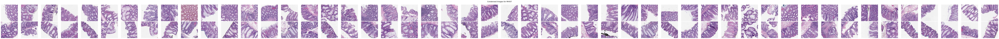

In [15]:
def visualize_condensed_images(synthetic_images, num_classes, images_per_class, title, save_folder):
    fig, axes = plt.subplots(num_classes, images_per_class, figsize=(images_per_class * 2, num_classes * 2))
    fig.suptitle(title)

    for class_id in range(num_classes):
        for img_id in range(images_per_class):
            idx = class_id * images_per_class + img_id
            # Permute the tensor to make it compatible with imshow (from CxHxW to HxWxC)
            img = synthetic_images[idx].permute(1, 2, 0).cpu().numpy()
            axes[class_id, img_id].imshow(img)
            axes[class_id, img_id].axis('off')

    plt.tight_layout()
    plt.savefig(f'{save_folder}/{title}.png')
    plt.show()

save_folder = 'Save_images'

# visualize MHIST when data is available
visualize_condensed_images(synthetic_images_tensor_mhist, num_classes_mhist, images_per_class_mhist, 
                           title="Condensed Images for MHIST", save_folder=save_folder)

# Part 1 Question 2(d):
Repeat parts 2b and 2c while the condensed images are initialized with Gaussian noise. Discuss in full detail the qualitative and quantitative results you have achieved. Are the results and visualizations are comparable with parts 2b and 2c?

# Repeat parts 2(b) while the condensed images are initialized with Gaussian noise

In [29]:
# Function to generate synthetic dataset S with Gaussian noise
# Reduce the standard deviation to make the noise less pronounced, leads to less spread in the distribution,......
# meaning values stay closer to the mean. This results in less noise.
def generate_synthetic_dataset_with_noise(real_dataset, num_classes, images_per_class, noise_std=0.8):
    synthetic_images = []
    synthetic_labels = []
    
    for class_id in range(num_classes):
        indices = random.sample(
            [i for i, (_, label) in enumerate(real_dataset) if label == class_id],
            images_per_class
        )
        for i in indices:
            # Generate Gaussian noise
            noise = torch.normal(mean=0, std=noise_std, size=real_dataset[i][0].size())
            synthetic_image = real_dataset[i][0] + noise
            
            # Ensure the pixel values are within valid range
            synthetic_image = torch.clamp(synthetic_image, 0, 1)
            
            synthetic_images.append(synthetic_image)
            synthetic_labels.append(real_dataset[i][1])
    
    return synthetic_images, synthetic_labels

In [30]:
# Generating synthetic samples for MHIST
synthetic_images_mhist_noise, synthetic_labels_mhist_noise = generate_synthetic_dataset_with_noise(
    mhist_train, num_classes_mhist, images_per_class_mhist
) 
# Convert synthetic images to a tensor
synthetic_images_tensor_mhist_noise = torch.stack(synthetic_images_mhist_noise).to(device)
synthetic_labels_tensor_mhist_noise = torch.tensor(synthetic_labels_mhist_noise).to(device)

# Create DataLoader for the synthetic MHIST dataset with noise
synthetic_dataset_mhist_noise = torch.utils.data.TensorDataset(synthetic_images_tensor_mhist_noise, synthetic_labels_tensor_mhist_noise)
synthetic_loader_mhist_noise = DataLoader(synthetic_dataset_mhist_noise, batch_size=batch_size_mhist, shuffle=True)

In [41]:
##### Save the synthetic images with noise ########
# Option 1: Save synthetic images as PNG files
# Create a directory to save the synthetic images
output_dir = "synthetic_images_mhist_noise"
os.makedirs(output_dir, exist_ok=True)

# Save each synthetic image as a PNG file
for idx, synthetic_image in enumerate(synthetic_images_mhist_noise):
    image_path = os.path.join(output_dir, f"synthetic_image_{idx}.png")
    save_image(synthetic_image, image_path)

print(f"Synthetic images saved in {output_dir}")

# Option 2: Save synthetic images and labels as a .pt file
torch.save({
    'images': synthetic_images_tensor_mhist_noise,
    'labels': synthetic_labels_tensor_mhist_noise
}, "synthetic_mhist_noise.pt")

print("Synthetic images and labels saved as 'synthetic_mhist_noise.pt'")

Synthetic images saved in synthetic_images_mhist_noise
Synthetic images and labels saved as 'synthetic_mhist_noise.pt'


In [32]:
# Training Function with Attention Matching
def train_with_attention_matching(model, synthetic_dataloader, optimizer, criterion, 
                                  param=0, exp=4, num_epochs=10, lambda_param=0.01):
    model.train()
    start_time = time.time()  # Start timing
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        for images, labels in synthetic_dataloader:
            optimizer.zero_grad()
            
            # Forward pass to get features
            features = model(images)
            # Get attention maps
            attention_maps = get_attention(features, param=param, exp=exp)
            
            # Compute loss with attention matching
            loss = criterion(features, labels)
            # Incorporate task balance parameter lambda
            loss += lambda_param * torch.mean(attention_maps)  # Adjust this based on your needs
            
            loss.backward()  # Backward pass
            optimizer.step()  # Optimize the model
            
            running_loss += loss.item()
        
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {running_loss / len(synthetic_dataloader):.4f}')
        total_training_time = time.time() - start_time  # Calculate total time
    print(f"Training Time on Real MHIST Dataset: {total_training_time:.2f} seconds")
    return total_training_time

# Optimizer setup for the model (using SGD as per the table)
optimizer_mhist_noise = torch.optim.SGD(convnet7.parameters(), lr=eta_theta_mhist)

# Train the model using the synthetic datasets with Gaussian noise
print("Training on MHIST dataset with Gaussian noise...")
train_with_attention_matching(convnet7, synthetic_loader_mhist_noise, optimizer_mhist_noise, 
                              F.cross_entropy, param=0, exp=4, num_epochs=T_mhist, lambda_param=lambda_mhist)

# Evaluate ConvNet7 on the test set
accuracy_attention_mhist_noise = evaluate_model(convnet7, mhist_test_loader)
print(f'ConvNet7 Test Accuracy on MHIST: {accuracy_attention_mhist_noise:.2f}%')

Training on MHIST dataset with Gaussian noise...
Epoch [1/10], Loss: 0.4029
Epoch [2/10], Loss: 0.3850
Epoch [3/10], Loss: 0.3682
Epoch [4/10], Loss: 0.3478
Epoch [5/10], Loss: 0.3314
Epoch [6/10], Loss: 0.3222
Epoch [7/10], Loss: 0.2983
Epoch [8/10], Loss: 0.2623
Epoch [9/10], Loss: 0.2663
Epoch [10/10], Loss: 0.2411
Training Time on Real MHIST Dataset: 147.81 seconds
ConvNet7 Test Accuracy on MHIST: 53.22%


# Repeat parts 2(c) while the condensed images are initialized with Gaussian noise

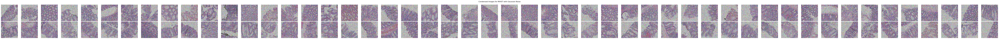

Image saved at: Save_images\Condensed_Images_for_MHIST_with_Gaussian_Noise.png


In [19]:
def visualize_condensed_images(synthetic_images_tensor, num_classes, images_per_class, save_dir, title):
    plt.figure(figsize=(images_per_class * 2, num_classes * 2))
    
    for class_id in range(num_classes):
        class_images = synthetic_images_tensor[class_id * images_per_class: (class_id + 1) * images_per_class]
        for i, image in enumerate(class_images):
            plt.subplot(num_classes, images_per_class, class_id * images_per_class + i + 1)
            # Permute the tensor to match (H, W, C) format and convert to numpy
            img = image.permute(1, 2, 0).cpu().detach().numpy()
            plt.imshow(img) 
            plt.axis('off')
            
    plt.suptitle(title)
    plt.tight_layout()
    
    save_path = os.path.join(save_dir, f"{title.replace(' ', '_')}.png")  # Define the path where the image will be saved
    plt.savefig(save_path)
    plt.show()
    print(f"Image saved at: {save_path}")
    
# Visualize and save condensed images for MHIST with Gaussian noise
visualize_condensed_images(synthetic_images_tensor_mhist_noise, num_classes_mhist, images_per_class_mhist, 
                           save_dir="Save_images", title="Condensed Images for MHIST with Gaussian Noise")

# Part 1 Question 2(e):
Now that you have had a chance to understand, learn, and visualize the condensed dataset, we can train the selected network from scratch on the condensed images. Train the selected network on a learned synthetic dataset (with 100 training images), then evaluate it on the
real testing data. Compare the test accuracy performance and the training time with part 2a. Explain your results. (For a fair comparison, you should use the exact same experimental setting as part 2a)

In [22]:
# Function to train the model on the synthetic condensed dataset
def train_model_on_synthetic(model, dataloader, optimizer, criterion, scheduler, num_epochs=20):
    model.train()  
    start_time = time.time()  

    for epoch in range(num_epochs):
        running_loss = 0.0
        for images, labels in dataloader:
            optimizer.zero_grad()  # Zero the parameter gradients
            outputs = model(images)  # Forward pass
            loss = criterion(outputs, labels)  # Compute loss
            loss.backward()  # Backward pass
            optimizer.step()  # Optimize the model
            running_loss += loss.item()
        
        scheduler.step()  # Step the learning rate scheduler
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(dataloader):.4f}')
    
    total_training_time = time.time() - start_time
    print(f"Training Time on Condensed Dataset: {total_training_time:.2f} seconds")
    return total_training_time

In [21]:
# Training on the condensed synthetic dataset (Part 2e)
print("\nTraining ConvNet7 on Condensed Synthetic Dataset...")
training_time_condensed = train_model_on_synthetic(convnet7, synthetic_loader_mhist, optimizer7, criterion, scheduler7)
print(f"Total Training Time on Condensed Dataset: {training_time_condensed:.2f} seconds")

# Evaluate model on the real test data (MHIST test set). This is the same evaluation model 'ConvNet7' applied to MHIST data in 2(a)
accuracy_synthetic_mhist = evaluate_model(convnet7, mhist_test_loader)
print(f'ConvNet7 Test Accuracy on Real MHIST after training on condensed dataset: {accuracy_synthetic_mhist:.2f}%')


Training ConvNet7 on Condensed Synthetic Dataset...
Epoch [1/20], Loss: 0.7084
Epoch [2/20], Loss: 0.7084
Epoch [3/20], Loss: 0.7084
Epoch [4/20], Loss: 0.7084
Epoch [5/20], Loss: 0.7084
Epoch [6/20], Loss: 0.7084
Epoch [7/20], Loss: 0.7084
Epoch [8/20], Loss: 0.7084
Epoch [9/20], Loss: 0.7084
Epoch [10/20], Loss: 0.7084
Epoch [11/20], Loss: 0.7084
Epoch [12/20], Loss: 0.7084
Epoch [13/20], Loss: 0.7084
Epoch [14/20], Loss: 0.7084
Epoch [15/20], Loss: 0.7084
Epoch [16/20], Loss: 0.7084
Epoch [17/20], Loss: 0.7084
Epoch [18/20], Loss: 0.7084
Epoch [19/20], Loss: 0.7084
Epoch [20/20], Loss: 0.7084
Training Time on Condensed Dataset: 256.93 seconds
Total Training Time on Condensed Dataset: 256.93 seconds
ConvNet7 Test Accuracy on Real MHIST after training on condensed dataset: 52.92%


In [22]:
# Input tensor for calculating FLOPs
input_tensor_mhist = torch.randn(200, channel_mhist, 224, 224)
flops_mhist = calculate_flops(convnet7, input_tensor_mhist)
print(f'FLOPs for ConvNet7: {flops_mhist:.2f} FLOPs')

[INFO] Register count_convNd() for <class 'torch.nn.modules.conv.Conv2d'>.
[INFO] Register zero_ops() for <class 'torch.nn.modules.activation.ReLU'>.
[INFO] Register count_avgpool() for <class 'torch.nn.modules.pooling.AvgPool2d'>.
[INFO] Register zero_ops() for <class 'torch.nn.modules.container.Sequential'>.
[INFO] Register count_linear() for <class 'torch.nn.modules.linear.Linear'>.
FLOPs for ConvNet7: 528143590400.00 FLOPs


# Part 1 Question 3: Cross-architecture Generalization
The ResNet18 is used in this section from Resnet18_mhist.py file to evaluate its cross-architecture performance in terms of classification accuracy
on the test sets.

In [33]:
from Resnet18_mhist import ResNet18
import torch
from torch.utils.data import DataLoader, TensorDataset
from torchvision import transforms

# Define parameters
model_name = 'ResNet18' 
channel = 3              
num_classes = 2          
im_size = (224, 224)        

transform_resize = transforms.Compose([
    transforms.Resize(im_size),  
    transforms.ToTensor()  
])

# Get the network instance using the ResNet18 function
resnet18 = ResNet18(channel=channel, num_classes=num_classes)

# Prepare the condensed MHIST dataset
synthetic_dataset_mhist = TensorDataset(torch.stack(synthetic_images_mhist), torch.tensor(synthetic_labels_mhist))
synthetic_loader_mhist = DataLoader(synthetic_dataset_mhist, batch_size=batch_size_mhist, shuffle=True)

# Define optimizer, criterion, and scheduler
optimizer_mhist = torch.optim.Adam(resnet18.parameters(), lr=0.001)
criterion_mhist = torch.nn.CrossEntropyLoss()
scheduler_mhist = torch.optim.lr_scheduler.StepLR(optimizer_mhist, step_size=10, gamma=0.1)

# Train ResNet18 on the condensed MHIST dataset
print("\nTraining ResNet18 on Condensed MHIST Dataset...")
training_time_mhist = train_model_on_synthetic(resnet18, synthetic_loader_mhist, optimizer_mhist, criterion_mhist, scheduler_mhist)

# Evaluate on the real MHIST test set
mhist_test_loader = DataLoader(mhist_test, batch_size=batch_size_mhist, shuffle=False)
mhist_accuracy = evaluate_model(resnet18, mhist_test_loader)
print(f'ResNet18 Test Accuracy on Real MHIST: {mhist_accuracy:.2f}%')


Training ResNet18 on Condensed MHIST Dataset...
Epoch [1/20], Loss: 12.5653
Epoch [2/20], Loss: 8.2542
Epoch [3/20], Loss: 4.9095
Epoch [4/20], Loss: 2.1053
Epoch [5/20], Loss: 1.4773
Epoch [6/20], Loss: 0.9929
Epoch [7/20], Loss: 1.2047
Epoch [8/20], Loss: 0.8317
Epoch [9/20], Loss: 0.8441
Epoch [10/20], Loss: 0.8386
Epoch [11/20], Loss: 0.7707
Epoch [12/20], Loss: 0.6573
Epoch [13/20], Loss: 0.6064
Epoch [14/20], Loss: 0.6111
Epoch [15/20], Loss: 0.6457
Epoch [16/20], Loss: 0.6527
Epoch [17/20], Loss: 0.6245
Epoch [18/20], Loss: 0.6019
Epoch [19/20], Loss: 0.5873
Epoch [20/20], Loss: 0.6291
Training Time on Condensed Dataset: 1942.70 seconds
ResNet18 Test Accuracy on Real MHIST: 44.32%


# Part 1 Question 4: Apply your synthetic small datasets to one of the machine learning applications
Apply synthetic small dataset to continual leaning. So this case we have to train a model and evaluate the trained model.
code is constructed by refering from: https://www.kaggle.com/code/dlarionov/continual-learning-on-permuted-mnist

 *As of the refered code they have applied the code to premuted MHIST (original MHIST) dataset, 
So as of the task II, i did not consider the premutation, instead I applied the train and test dataset to the model. 
For this I used the Convnet3 model as I have used this to train the systhetic dataset earlier.*

# Part II as of the experiment set up for continual learning in paper: 
DATASET CONDENSATION WITH GRADIENT MATCHING

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torchvision.datasets as datasets
import torchvision.transforms as T
import torch.nn.functional as F
import torch.optim as optim
import random
from torch.utils.data import Subset
from torch.utils.data import TensorDataset

In [34]:
# Set seeds for reproducibility
seed = 0
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)

# Device and hyperparameters
# device = torch.device("cpu")
train_bs = 64 # Training batch size
test_bs = 2000  # Testing batch size
lr = 0.01  # Learning rate
gamma = 0.9  # Decay factor
num_tasks = 3  # Number of tasks 

In [35]:
# To create growing test sets at different stages: 2,000, 4,000, and 6,000 images
def get_test_subset(dataset, size):
    size = min(size, len(dataset)) 
    indices = np.random.choice(len(dataset), size, replace=False)
    subset = Subset(dataset, indices)
    return DataLoader(subset, batch_size=batch_size_mhist, shuffle=False)

In [36]:
num_images = 100  
num_classes_mhist = 2  
image_size = 224 * 224  
channels = 3    
height = 224      
width = 224       

# Resize MHIST images 
transform_resize = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to 224x224
    transforms.Grayscale(num_output_channels=3),  # Ensure 3 channels (RGB)
    transforms.ToTensor()  # Convert to tensor
])
synthetic_images_tensor_mhist = torch.rand(num_images, channels, height, width) 

In [37]:
# Define Replay Buffer
class ReplayBuffer:
    def __init__(self, buffer_size=100):
        self.buffer = []
        self.buffer_size = buffer_size

    def add_to_buffer(self, samples):
        for sample in samples:
            # Ensure each sample has the correct number of elements
            if len(sample) == 2:
                input_tensor, target_tensor = sample
                # Reshape the target tensor to ensure it is a single element
                target_tensor = target_tensor.view(-1)  # Flatten to ensure it is a 1D tensor
                self.buffer.append((input_tensor, target_tensor))
                
                # Maintain buffer size
                if self.buffer_size and len(self.buffer) > self.buffer_size:
                    self.buffer.pop(0)  # Remove oldest sample if buffer exceeds size
            else:
                print(f"Unexpected sample shape: {sample}")

    def sample_from_buffer(self, batch_size):
        samples = random.sample(self.buffer, min(len(self.buffer), batch_size))

        inputs = [sample[0] for sample in samples]
        targets = [sample[1] for sample in samples]

        inputs_tensor = torch.stack(inputs) if inputs else torch.empty(0)
        targets_tensor = torch.stack(targets) if targets else torch.empty(0)

        return list(zip(inputs_tensor, targets_tensor))

In [38]:
import torch.nn.functional as F
# Train model with replay buffer
def train_model_with_replay(model, device, synthetic_loader, replay_buffer, optimizer, criterion, scheduler, replay_ratio=0.3):
    model.train()
    synthetic_data_iter = iter(synthetic_loader)
    total_steps = len(synthetic_loader)
    
    for step in range(total_steps):
        # Get current batch from synthetic data
        try:
            synthetic_batch = next(synthetic_data_iter)
        except StopIteration:
            synthetic_data_iter = iter(synthetic_loader)
            synthetic_batch = next(synthetic_data_iter)
        
        # Sample from replay buffer
        replay_batch = replay_buffer.sample_from_buffer(int(replay_ratio * len(synthetic_batch[0])))

        # Debugging shapes
        print(f"Synthetic batch shape: {synthetic_batch[0].shape}")
        print(f"Replay batch size: {len(replay_batch)}")

        # Add synthetic data to replay buffer
        synthetic_samples = list(zip(
            synthetic_images_tensor_mhist.view(-1, 3, 224, 224),
            synthetic_labels_tensor_mhist
        ))
        replay_buffer.add_to_buffer(synthetic_samples)  # Add synthetic data to the replay buffer

        # Combine synthetic data with replay data
        if replay_batch:
            print("Replay batch shapes:")
            for i, (input_tensor, target_tensor) in enumerate(replay_batch):
                print(f"Replay input shape[{i}]: {input_tensor.shape}, Replay target shape[{i}]: {target_tensor.shape}")
        
            # Ensure replay input tensors have the correct shape
            target_shape = (224, 224)  # Set target size for height and width
            replay_inputs = []
        
            for x in replay_batch:
                input_tensor = x[0]
        
                # Adjust the shape of the input tensor if necessary
                if input_tensor.dim() == 3:  # If 3D (H, W, C), add a channel dimension
                    input_tensor = input_tensor.unsqueeze(0)  # Convert to (1, H, W, C)
        
                # Resize to the target shape
                input_tensor = F.interpolate(input_tensor, size=target_shape, mode='bilinear', align_corners=False)
        
                # Repeat the channels if needed
                if input_tensor.shape[1] != 3:  # If channels are not 3
                    input_tensor = input_tensor.repeat(1, 3, 1, 1)  # Repeat to match channel size
                
                replay_inputs.append(input_tensor)
        
            # Print shapes after adjustments
            for i, input_tensor in enumerate(replay_inputs):
                print(f"Adjusted replay input shape[{i}]: {input_tensor.shape}")
        
            # Check if synthetic_batch[0] needs to be adjusted
            synthetic_input = synthetic_batch[0]
            if synthetic_input.dim() == 3:  # If synthetic input is also 3D
                synthetic_input = synthetic_input.unsqueeze(0)  # Convert to (1, H, W, C)
        
            # Resize synthetic input to the target shape
            synthetic_input = F.interpolate(synthetic_input, size=target_shape, mode='bilinear', align_corners=False)
        
            # Now concatenate the inputs and targets
            combined_inputs = torch.cat([synthetic_input] + replay_inputs, dim=0)  # Concatenate along the batch dimension
            combined_targets = torch.cat([synthetic_batch[1]] + [x[1] for x in replay_batch], dim=0)
        else:
            combined_inputs, combined_targets = synthetic_batch
        
        # Move combined inputs and targets to the specified device
        combined_inputs, combined_targets = combined_inputs.to(device), combined_targets.to(device)

        # Forward pass
        optimizer.zero_grad()
        output = model(combined_inputs)
        loss = criterion(output, combined_targets)
        loss.backward()
        optimizer.step()
    
    # Update learning rate
    scheduler.step()

In [43]:
# Test function with growing test set
def test1_with_growing_test_set(model, device, mhist_test):
    # Define the sizes for the growing test sets
    test_set_sizes = [2000, 4000, 6000]
    metrics = []
    replay_buffer = ReplayBuffer(buffer_size=8000)  # Replay buffer with a limit of 8000 samples
    
    # Evaluate untrained model on MHIST test subsets
    for size in test_set_sizes:
        test_loader = get_test_subset(mhist_test, size)
        test_acc = evaluate_model(model, test_loader)
        print(f"Test accuracy on {size} images: {test_acc:.2f}%")
        metrics.append(test_acc)
    
    for i in range(num_tasks):
        print(f'Train on Task {i + 1}')
        synthetic_loader, synthetic_data = tasks[i]  # Unpack the task
        optimizer = torch.optim.Adadelta(model.parameters(), lr=lr)
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=gamma)
        
        # Train the model on the current task using memory replay
        train_model_with_replay(model, device, synthetic_loader, replay_buffer, optimizer, criterion, scheduler)
        
        # Add the synthetic data to the replay buffer
        replay_buffer.add_to_buffer(synthetic_data.tensors)
        
        # Evaluate the model on different MHIST test set sizes
        for size in test_set_sizes:
            test_loader = get_test_subset(mhist_test, size)
            test_acc = evaluate_model(model, test_loader)
            print(f"Test accuracy after training on Task {i+1} with {size} test images: {test_acc:.2f}%")
            metrics.append(test_acc)
    
    return metrics  

In [44]:
# Create synthetic labels
synthetic_labels_tensor_mhist = torch.randint(0, num_classes_mhist, (num_images,)) 
synthetic_images_tensor_mhist = torch.rand(num_images, 3, 224, 224) 

# Create the synthetic dataset with the reshaped images
synthetic_dataset_mhist = TensorDataset(synthetic_images_tensor_mhist, synthetic_labels_tensor_mhist)

# Create tasks for different dataset sizes
max_size = min(num_images, 2000 * num_tasks)  
tasks = [
    (DataLoader(TensorDataset(
        synthetic_images_tensor_mhist[:2000 * (i + 1)], 
        synthetic_labels_tensor_mhist[:2000 * (i + 1)]
    ), batch_size=64, shuffle=True), 
    TensorDataset(
        synthetic_images_tensor_mhist[:2000 * (i + 1)], 
        synthetic_labels_tensor_mhist[:2000 * (i + 1)]
    ))
    for i in range(num_tasks)
]
# print("Synthetic images shape:", synthetic_images_tensor_mhist.shape)
# print("Synthetic labels shape:", synthetic_labels_tensor_mhist.shape)

In [45]:
# Experimenting multiple times (this case: 5 runs), compute the mean and standard deviation, and report them
all_experiments = []
num_experiments = 5
convnet7 = get_network('ConvNetD7', channel_mhist, num_classes_mhist, im_size_mhist).to('cpu')
for experiment in range(num_experiments):
    print(f"Running Experiment {experiment + 1}")
    model = convnet7.to(device)  # Reset the model for each experiment
    degr_profile = test1_with_growing_test_set(model, device, mhist_test)
    all_experiments.append(degr_profile)

# Convert results to numpy array for easy computation of mean and std
all_experiments = np.array(all_experiments)

mean_results = np.mean(all_experiments, axis=0)
std_results = np.std(all_experiments, axis=0)

# Print mean and std for each task
for i, (mean, std) in enumerate(zip(mean_results, std_results)):
    print(f"Task {i + 1} - Mean accuracy: {mean:.4f}, Standard deviation: {std:.4f}")

Running Experiment 1
Test accuracy on 2000 images: 54.76%
Test accuracy on 4000 images: 54.76%
Test accuracy on 6000 images: 54.76%
Train on Task 1
Synthetic batch shape: torch.Size([64, 3, 224, 224])
Replay batch size: 0
Synthetic batch shape: torch.Size([36, 3, 224, 224])
Replay batch size: 10
Replay batch shapes:
Replay input shape[0]: torch.Size([3, 224, 224]), Replay target shape[0]: torch.Size([1])
Replay input shape[1]: torch.Size([3, 224, 224]), Replay target shape[1]: torch.Size([1])
Replay input shape[2]: torch.Size([3, 224, 224]), Replay target shape[2]: torch.Size([1])
Replay input shape[3]: torch.Size([3, 224, 224]), Replay target shape[3]: torch.Size([1])
Replay input shape[4]: torch.Size([3, 224, 224]), Replay target shape[4]: torch.Size([1])
Replay input shape[5]: torch.Size([3, 224, 224]), Replay target shape[5]: torch.Size([1])
Replay input shape[6]: torch.Size([3, 224, 224]), Replay target shape[6]: torch.Size([1])
Replay input shape[7]: torch.Size([3, 224, 224]), Re

          ############################# Code ends here for MHIST Dataset  ####################################